In [4]:
using Pkg

In [6]:
Pkg.add("LaTeXStrings")

   Resolving package versions...
    Updating `C:\Users\PC\.julia\environments\v1.10\Project.toml`
  [b964fa9f] + LaTeXStrings v1.3.1
  No Changes to `C:\Users\PC\.julia\environments\v1.10\Manifest.toml`


In [ ]:

using LinearAlgebra

In [8]:
using Plots,LaTeXStrings,Measures;

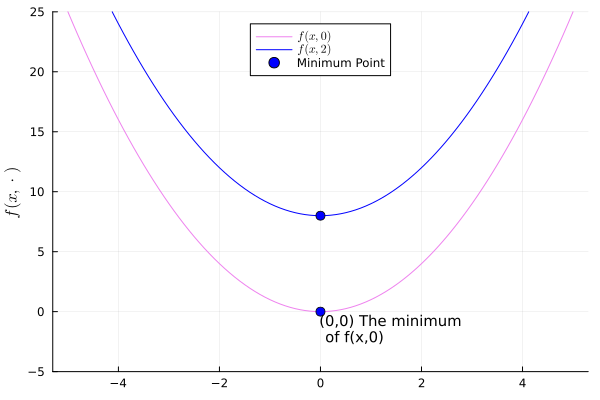

In [50]:
f(x,y)=x^2+y^2
f0(x) = f(x,0)
f2(x) = f(x,2)
xVals,yVals=-5:0.1:5 ,-5:0.1:5 #range of values
plot(xVals,[f0.(xVals), f2.(xVals)],c=[:violet  :blue],legend=:top,
ylims=(-5,25), ylabel=L"f(x,\cdot)", label=[L"f(x,0)" L"f(x,2)"])
p1 = annotate!(0,0.2, text("(0,0) The minimum\n of f(x,0)", :left, :top, 10))
xmin1,ymin1=0,0
xmin2,ymin2=0,8
scatter!([xmin1,xmin2], [ymin1,ymin2], color=:blue, markersize=5, label="Minimum Point")

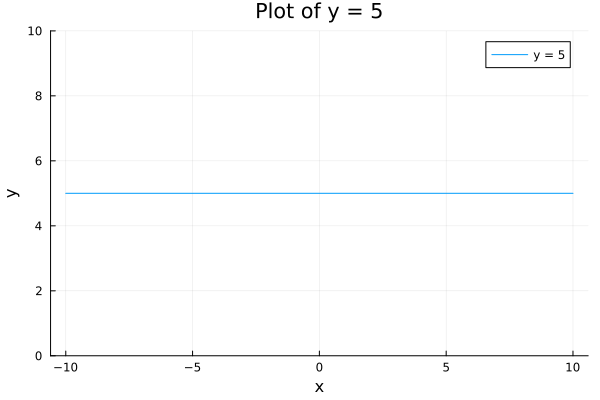

In [29]:
using Plots

# Define the line equation y = 5
y = 5

# Generate x values (e.g., from -10 to 10)
x = -10:0.1:10

# Create an array of y values of the same length as x
y_values = fill(y, length(x))

# Plot the line
plot(x, y_values, label="y = 5",ylims=(0,10), xlabel="x", ylabel="y", title="Plot of y = 5")



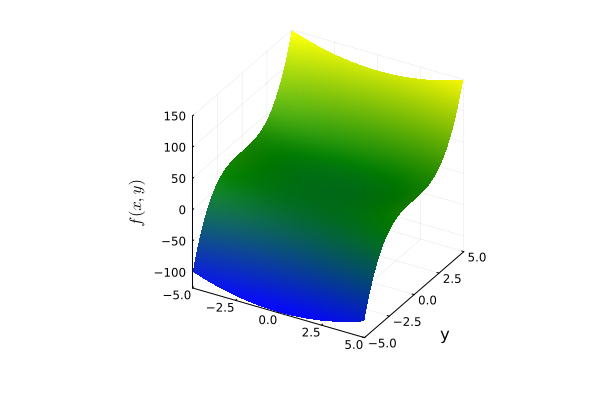

In [55]:
z=[f(x,y) for y in yVals,x in xVals]
surface(xVals,yVals,z,c=cgrad([:blue,:green,:yellow]),legend=:none, ylabel="y", zlabel=L"f(x,y)")

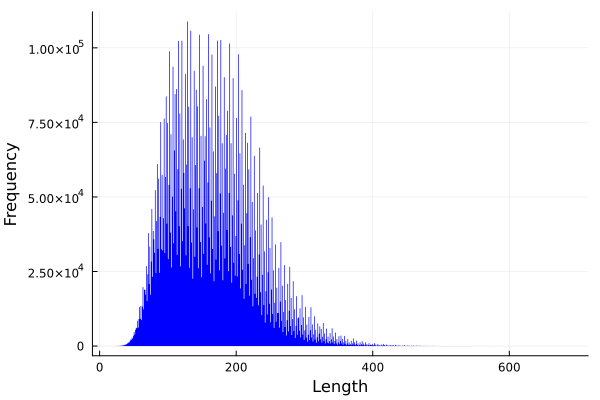

In [61]:
using Plots;
#Create Histogram of Hailstone Sequence Lengths
function hailLength(x::Int)
    n=0
    while x!=1
        if x%2==0
            x=Int(x/2)
        else
            x=3x+1
        end 
        n+=1

    end
    return n
end
lengths=[hailLength(x0) for x0 in 2:10^7]


histogram(lengths,bins=1000,
 fill=(:blue, true),la=0,legend=:none,

 xlabel="Length",ylabel="Frequency")

┌ Info: Saved animation to c:\Users\PC\graph.gif
└ @ Plots C:\Users\PC\.julia\packages\Plots\du2dt\src\animation.jl:156


Plots.AnimatedGif("c:\\Users\\PC\\graph.gif")
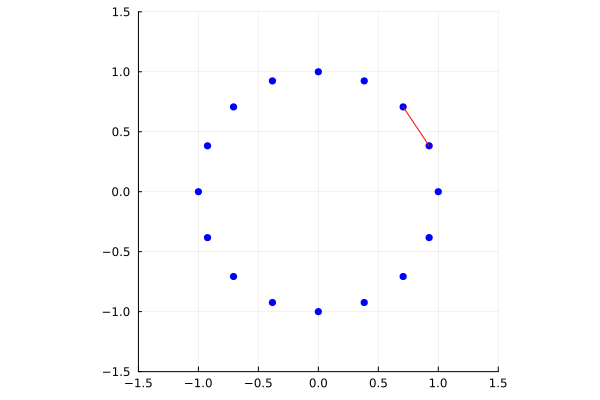

In [16]:

using Plots;
function graphCreator(n::Int)
    vertices =1:n
    f(k)= exp(2*pi*im*k/n)
    complexPts = [f(i) for i in vertices]
    coords=[(real(p),imag(p)) for p in complexPts]
    xPts = first.(coords)
    yPts = last.(coords)
    edges=[]
    for v in vertices , u in (v+1):n
        push!(edges,(v,u))
    end
   anim=Animation()
    plot()
    scatter(xPts,yPts,c=:blue,msw=0,ratio=1,xlims=(-1.5,1.5),ylims=(-1.5,1.5),legend=:none)



    for i in 1:length(edges)
        u,v = edges[i][1],edges[i][2]
         xpoints=[xPts[u],xPts[v]]
         ypoints=[yPts[u],yPts[v]]
         plot!(xpoints,ypoints,line=(:red))
        frame(anim)
    end
    
   gif(anim,"graph.gif",fps=60)
  
end
 graphCreator(16)
       

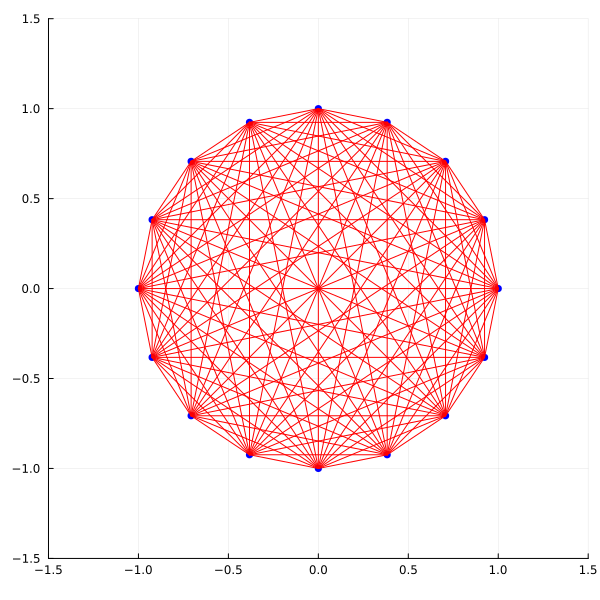

In [18]:
using Plots

function graphCreator(n::Int)
    vertices = 1:n
    f(k) = exp(2*pi*im*k/n)
    complexPts = [f(i) for i in vertices]
    coords = [(real(p), imag(p)) for p in complexPts]
    xPts = first.(coords)
    yPts = last.(coords)
    edges = []
    for v in vertices, u in (v+1):n
        push!(edges, (v, u))
    end
    p = plot(size=(600, 600), xlims=(-1.5, 1.5), ylims=(-1.5, 1.5), legend=:none)
    scatter!(p,xPts, yPts, c=:blue, msw=0, ratio=1, xlims=(-1.5, 1.5), ylims=(-1.5, 1.5), legend=:none)

    for i in 1:length(edges)
        u, v = edges[i]
        xpoints = [xPts[u], xPts[v]]
        ypoints = [yPts[u], yPts[v]]
        plot!(p,xpoints, ypoints, line=(:red))
    end

    display(p)  # Display the plot
end

graphCreator(16)  # Call the function to generate and display the plot


Pi Estimate: 3.1384


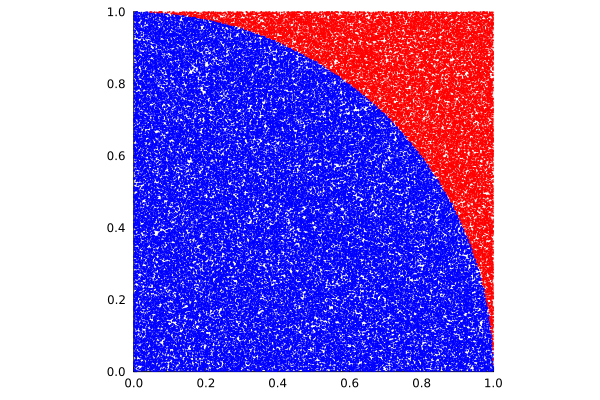

In [22]:
#Monte Carlo simulation method
using Random,LinearAlgebra,Plots;
Random.seed!()
N=10^5
data=[[rand(),rand()] for _ in 1:N]
indata=filter((x)-> (norm(x)<=1),data)
outdata= filter((x)-> (norm(x)>1),data)
piApprox=4*length(indata)/N
println("Pi Estimate: ", piApprox)
scatter(first.(indata),last.(indata), c=:blue, ms=1, msw=0)

scatter!(first.(outdata),last.(outdata), c=:red, ms=1, msw=0,
xlims=(0,1), ylims=(0,1), legend=:none, ratio=:equal)

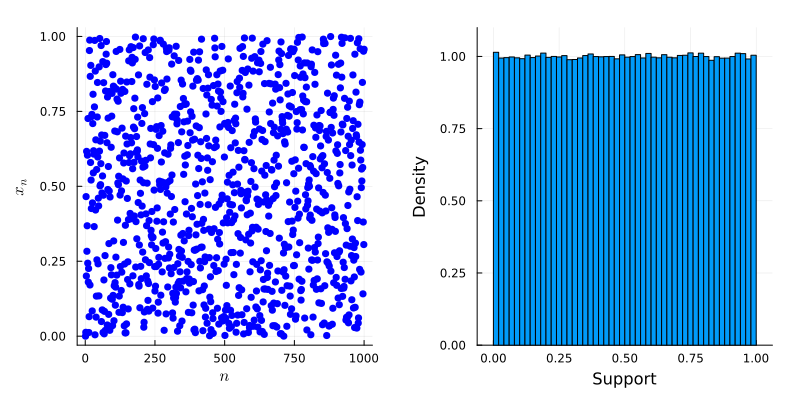

In [30]:
using Plots,LaTeXStrings,Measures;
a,c,m =69069,1,2^32
LCG(x) =(a*x +c )%m
N=10^6;
data=Array{Float64,1}(undef,N)

x=808
for i in 1:N
    data[i] = x/m
    global x = LCG(x)
end
 p1=scatter(1:1000,data[1:1000],
c=:blue,m=4,msw=0,xlabel=L"n",ylabel=L"x_n",legend=:none)

p2= histogram(data,bins=50,normed=:true, ylims=(0,1.1),xlabel="Support",ylabel="Density")
plot(p1,p2,size=(800,400),legend=:none,margin=5mm)


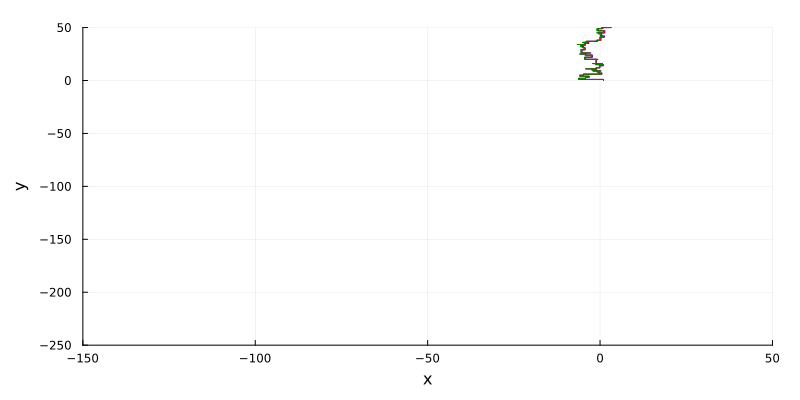

In [5]:
using Plots,Random,Measures;
function path(rng,alpha,n=5000)
    x,y=0.0,0.0
    xDat,yDat= [],[]
    for _ in 1:n
        flip=rand(rng,1:4)
        if flip ==1
            x+=1
        elseif flip==2
            y+=1
        elseif flip == 3
            x-=(2+alpha)*rand(rng)
        end
        push!(xDat,x)
        push!(yDat,y)

    end
    return xDat,yDat

end

alphaRange=[0.2,0.21,0.22]
default(xlabel="x",ylabel="y",xlims=(-150,50),ylims=(-250,50))
p1=plot(path(MersenneTwister(27),alphaRange[1]),c=:blue)
p1=plot!(path(MersenneTwister(27),alphaRange[2]),c=:red)
p1=plot!(path(MersenneTwister(27),alphaRange[3]),c=:green)

rng = MersenneTwister(27)
p2=plot(path(rng,alphaRange[1]),c=:blue)
p2=plot!(path(rng,alphaRange[2]),c=:red)
p2=plot!(path(rng,alphaRange[3]),c=:green)
plot(p1,p2,size=(800,400),legend=:none,margin=5mm)


In [7]:
N,faces=10^6 , 1:6
numSol = sum([iseven(i+j) for i in faces, j in faces]) / length(faces)^2
 mcEst = sum([iseven(rand(faces) + rand(faces)) for _ in 1:N]) / N

 println("Numerical solution = $numSol \nMonte Carlo estimate = $mcEst")
 iseven(0)

Numerical solution = 0.5 
Monte Carlo estimate = 0.499366


true